### Create Civil Engineering and Pharmaceuticals Patent Inventor Location Maps
##### All Inventors vs Women Inventors

In [1]:
import pandas as pd
import plotly.express as px
import plotly.io as pio
import tenacity

##### Civil Engineering Patent Inventors

In [2]:
# read in data

df = pd.read_csv("../../../data/PatentsView/final/civil_inv_loc_map_data.csv")

In [3]:
df.dtypes

location_id       object
year               int64
city              object
state             object
latitude         float64
longitude        float64
inv_cnt_M          int64
inv_cnt_UNK        int64
inv_cnt_W          int64
inv_cnt_TOTAL      int64
dtype: object

In [4]:
df.isnull().sum()

location_id         0
year                0
city               24
state              17
latitude         2289
longitude        2289
inv_cnt_M           0
inv_cnt_UNK         0
inv_cnt_W           0
inv_cnt_TOTAL       0
dtype: int64

In [5]:
df = df.sort_values(by=['year'], ascending=True)

In [6]:
df.head()

,location_id,year,city,state,latitude,longitude,inv_cnt_M,inv_cnt_UNK,inv_cnt_W,inv_cnt_TOTAL
45348,5acc7e10-cb8f-11eb-9615-121df0c29c1e,1976,Charlottesville,VA,38.0401,-78.4777,1,0,0,1
62721,9c96693c-cb8e-11eb-9615-121df0c29c1e,1976,Clinton,IA,41.8798,-90.5331,1,0,0,1
62707,9c750163-cb8e-11eb-9615-121df0c29c1e,1976,Concord,TN,35.9787,-88.8331,2,0,0,2
62698,9c5d04aa-cb8e-11eb-9615-121df0c29c1e,1976,Roseboro,NC,34.9548,-78.5137,1,0,0,1
32557,44479707-cb8e-11eb-9615-121df0c29c1e,1976,Seneca Falls,NY,42.9078,-76.7966,1,0,0,1


In [7]:
max(df['inv_cnt_TOTAL'])

1337

In [8]:
# create figure for all inventors

fig = px.scatter_geo(df,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=['#B66DFF'],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_TOTAL",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_TOTAL']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color='#B66DFF',
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors: %{customdata[2]}')

fig.update_layout(
        title = 'Civil Engineering Patent Inventor Locations - All',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000

In [9]:
#fig.frames
#fig.data[0].hovertemplate
#fig["data"]

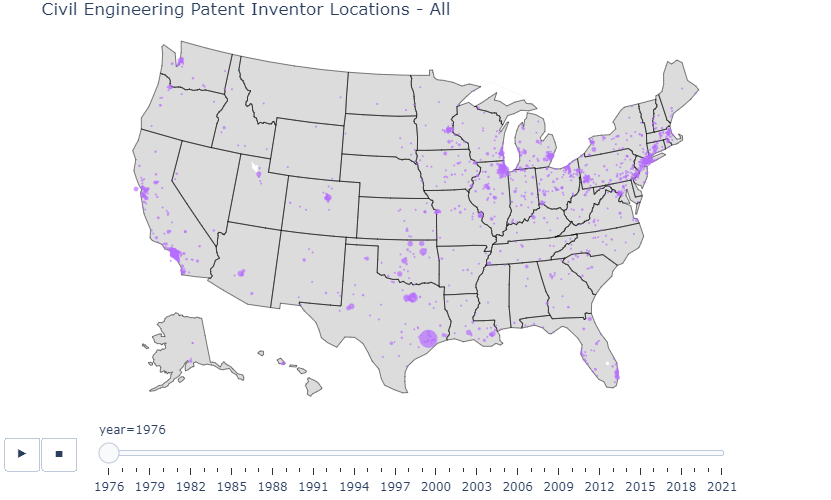

In [10]:
fig.show()

In [11]:
# write figure to HTML

pio.write_html(fig, file='../../../docs/civil_all_locations.html', auto_open=True)

In [13]:
# filter data to locations that have 1+ women inventors

df_w = df[df['inv_cnt_W'] > 0]

In [14]:
max(df_w['inv_cnt_W'])

129

In [15]:
# to find appropriate size max: 1337/30 = 129/?
# leave size max the same for both - best for viewing. Just note different scales.

30*129/1337

2.894540014958863

In [18]:
# # create figure for inventors who are women

fig = px.scatter_geo(df_w,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=["#DB6D00"],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_W",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_W']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color="#B66DFF",
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors - Women: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors - Women: %{customdata[2]}')

fig.update_layout(
        title = 'Civil Engineering Patent Inventor Locations - Women',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000


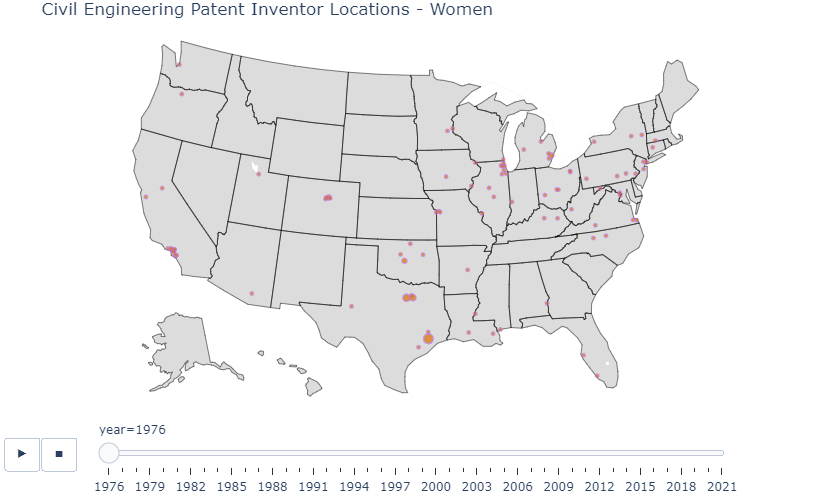

In [19]:
fig.show()

In [20]:
# write figure to HTML

pio.write_html(fig, file='../../../docs/civil_women_locations.html', auto_open=True)

##### Pharmaceuticals Patent Inventors

In [21]:
# read in data

df = pd.read_csv("../../../data/PatentsView/final/pharma_inv_loc_map_data.csv")

In [22]:
df.dtypes

location_id       object
year               int64
city              object
state             object
latitude         float64
longitude        float64
inv_cnt_M          int64
inv_cnt_W          int64
inv_cnt_UNK        int64
inv_cnt_TOTAL      int64
dtype: object

In [23]:
df.isnull().sum()

location_id         0
year                0
city               38
state              29
latitude         3250
longitude        3250
inv_cnt_M           0
inv_cnt_W           0
inv_cnt_UNK         0
inv_cnt_TOTAL       0
dtype: int64

In [24]:
df = df.sort_values(by=['year'], ascending=True)

In [25]:
df.head()

,location_id,year,city,state,latitude,longitude,inv_cnt_M,inv_cnt_W,inv_cnt_UNK,inv_cnt_TOTAL
50476,b973bf32-cb90-11eb-9615-121df0c29c1e,1976,Mendham,NJ,40.7692,-74.5992,3,0,0,3
27792,4f93f5d7-cb8e-11eb-9615-121df0c29c1e,1976,Scarsdale,NY,40.9691,-73.7635,1,0,0,1
57876,d3b7ecad-cb8f-11eb-9615-121df0c29c1e,1976,Old Lyme,CT,41.3159,-72.3290,4,0,0,4
41778,93de88e5-cb8e-11eb-9615-121df0c29c1e,1976,Plainfield,NJ,40.6194,-74.4077,3,0,0,3
46592,a978b3b3-cb8e-11eb-9615-121df0c29c1e,1976,West Norriton,PA,40.1296,-75.3785,1,0,0,1


In [26]:
max(df['inv_cnt_TOTAL'])

913

In [27]:
# create figure for all inventors

fig = px.scatter_geo(df,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=['#004949'],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_TOTAL",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_TOTAL']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color='#004949',
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors: %{customdata[2]}')

fig.update_layout(
        title = 'Pharmaceuticals Patent Inventor Locations - All',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000

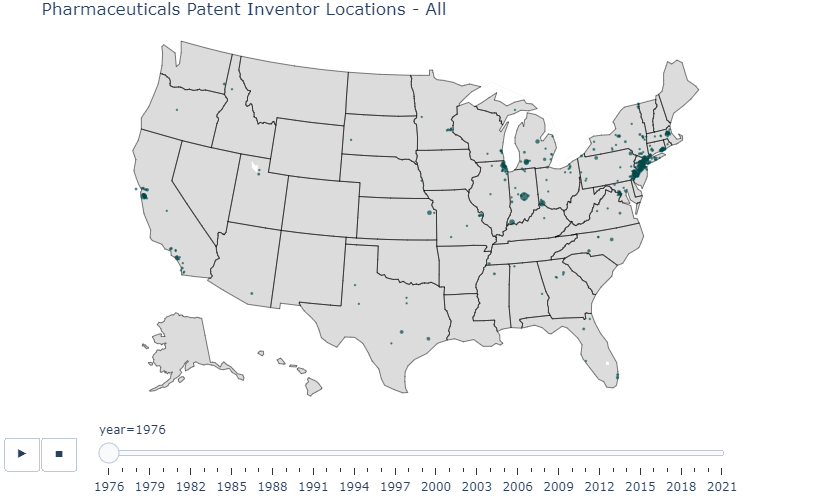

In [28]:
fig.show()

In [29]:
# write figure to HTML

pio.write_html(fig, file='../../../docs/pharma_all_locations.html', auto_open=True)

In [30]:
# filter data to locations that have 1+ women inventors

df_w = df[df['inv_cnt_W'] > 0]

In [31]:
max(df_w['inv_cnt_W'])

211

In [32]:
# # create figure for inventors who are women

fig = px.scatter_geo(df_w,
                      lat="latitude",
                      lon="longitude",
                      #color="year",
                      color_discrete_sequence=["#DB6D00"],
                      size_max=30,
                      #hover_name="city",
                      size="inv_cnt_W",
                      animation_frame="year",
                      projection="albers usa",
                      #labels={"country_code": "Country"},
                      custom_data=['city', 'state', 'inv_cnt_W']
                     )

fig.update_traces(marker=dict(
        # color='navy',
        line=dict(
            color="#004949",
            width=1
        )    
    )
)

fig.update_traces(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors - Women: %{customdata[2]}')    
for f in fig.frames:
    f.data[0].update(hovertemplate = '%{customdata[0]}, %{customdata[1]} <br>Inventors - Women: %{customdata[2]}')

fig.update_layout(
        title = 'Pharmaceuticals Patent Inventor Locations - Women',
        margin=dict(l=20, r=20, t=30, b=0),
        width = 800,
        height = 500,
        geo = dict(  # geo options from: https://plotly.com/python/scatter-plots-on-maps/
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = 'gainsboro', #"rgb(250, 250, 250)",
            subunitcolor = 'black', #"rgb(217, 217, 217)",
            countrycolor = 'black', #"rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )

fig.update_layout(sliders=[dict(pad={"t": 15}, len=0.8)])

fig.update_layout(updatemenus=[dict(type='buttons',
                  showactive=False,
                  y=-0.18,
                  x=-0.02,
                  xanchor='left',
                  yanchor='bottom')
                ])

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 3000


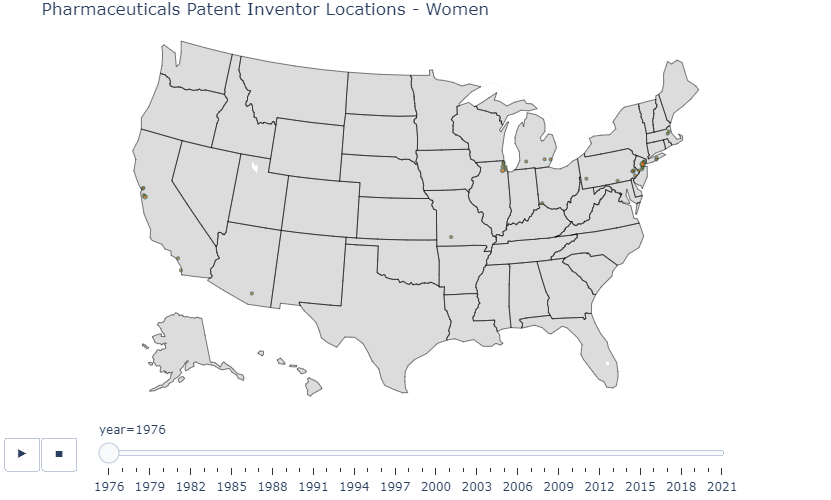

In [33]:
fig.show()

In [34]:
# write figure to HTML

pio.write_html(fig, file='../../../docs/pharma_women_locations.html', auto_open=True)